In [12]:
using Plots

include("src/PolyColloid.jl")
using .PolyColloid

using CUDA
CUDA.allowscalar(true)

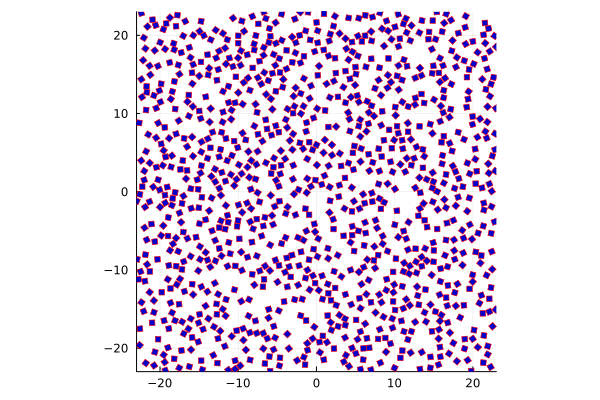

In [13]:
n = 1024
sim = PolyColloid.Simulation(n, 4, 0.5, (ceil(Int, √(2n)), ceil(Int, √(2n))), gpu=true)
PolyColloid.crystallize!(sim.colloid)
sim.move_radius = 0.25
sim.rotation_span = π / 8
push!(sim.recorders, PolyColloid.TrajectoryRecorder(t -> t % (n ÷ 12) == 0, savetomem=true))
PolyColloid.run!(sim, 5n)
plot(sim.colloid)

Plots.AnimatedGif("d:\\University\\PolyColloid\\code\\anim\\mix.gif")
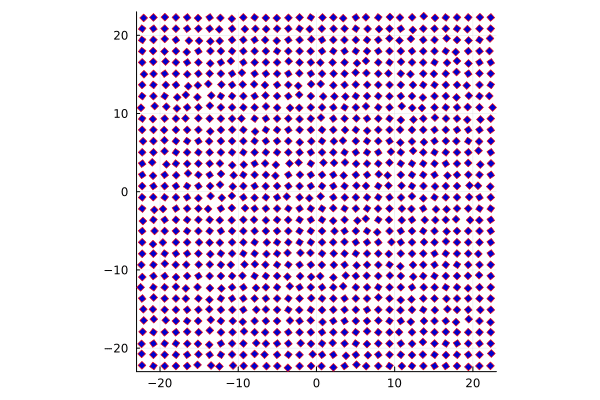

┌ Info: Saved animation to d:\University\PolyColloid\code\anim\mix.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [14]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    p = plot(sim.recorders[1].trajectory[i])
    frame(anim, p)
end
anim_out = gif(anim, "../anim/mix.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)

In [15]:
pop!(sim.recorders)
push!(sim.recorders, PolyColloid.TrajectoryRecorder(t -> t % (n ÷ 4) == 0, savetomem=true))

1-element Vector{Main.PolyColloid.AbstractRecorder}:
 Main.PolyColloid.TrajectoryRecorder(nothing, 0, nothing, true, false, var"#27#28"())

In [16]:
p_area = PolyColloid.particle_area(sim.colloid)
initial_area_fraction = (PolyColloid.particle_count(sim.colloid) * p_area
                         / PolyColloid.boxarea(sim.colloid))

0.24196597353497165

In [17]:
final_area_fraction = 0.8
target_sidelen = Float32(√(PolyColloid.particle_count(sim.colloid) * p_area / final_area_fraction))

25.298222f0

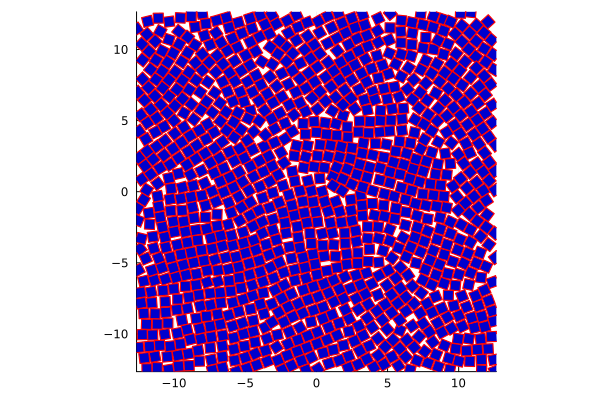

In [18]:
push!(sim.updaters, PolyColloid.MoveSizeTuner(t -> t % 50 == 0, 0.2;
    max_move_radius=0.25, max_rotation_span=π/8))
push!(sim.updaters, PolyColloid.ForcefulCompressor(t -> t % 100 == 0, (target_sidelen, target_sidelen)))
PolyColloid.run!(sim, 20n)
plot(sim.colloid)

Plots.AnimatedGif("d:\\University\\PolyColloid\\code\\anim\\compress.gif")
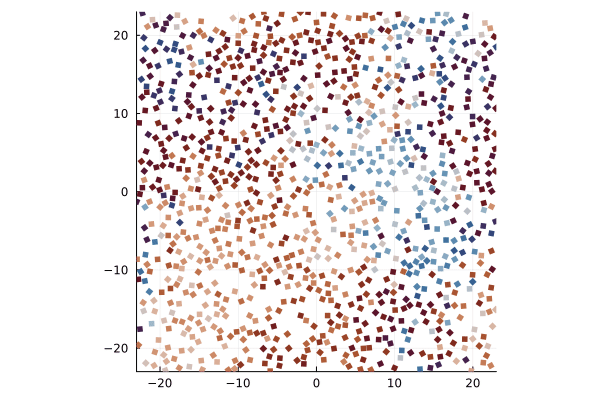

┌ Info: Saved animation to d:\University\PolyColloid\code\anim\compress.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [19]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    p = plot(sim.recorders[1].trajectory[i],
             [mod(angle, π/2) / (π/2) for angle in Array(sim.colloid.angles)])
    frame(anim, p)
end
anim_out = gif(anim, "../anim/compress.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)

In [20]:
pop!(sim.recorders)
push!(sim.recorders, PolyColloid.TrajectoryRecorder(t -> t % n == 0, savetomem=true))

1-element Vector{Main.PolyColloid.AbstractRecorder}:
 Main.PolyColloid.TrajectoryRecorder(nothing, 0, nothing, true, false, var"#35#36"())

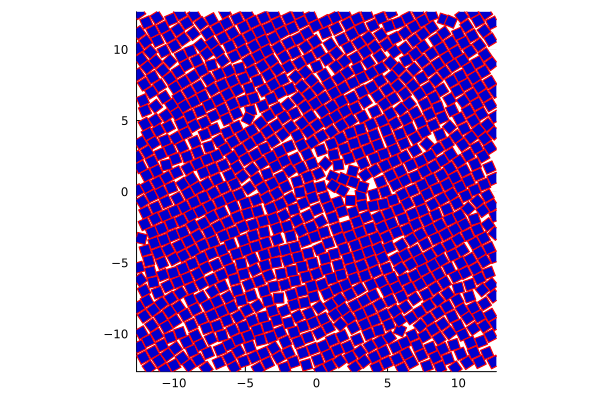

In [21]:
PolyColloid.run!(sim, 100n)
plot(sim.colloid)

Plots.AnimatedGif("d:\\University\\PolyColloid\\code\\anim\\equilibrium.gif")
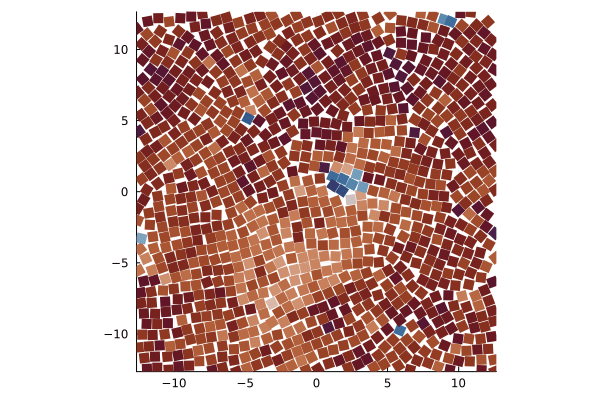

┌ Info: Saved animation to d:\University\PolyColloid\code\anim\equilibrium.gif
└ @ Plots C:\Users\SLHHe\.julia\packages\Plots\sxUvK\src\animation.jl:156


In [22]:
anim = Animation("../anim/frames/", String[])
for i in 1:length(sim.recorders[1].trajectory)
    p = plot(sim.recorders[1].trajectory[i],
             [mod(angle, π/2) / (π/2) for angle in Array(sim.colloid.angles)])
    frame(anim, p)
end
anim_out = gif(anim, "../anim/equilibrium.gif", fps=15)
rm("../anim/frames", recursive=true)
mkdir("../anim/frames")
display(anim_out)